In [1]:
import pandas as pd
import os
import seaborn as sns
path = 'data/'

df = pd.read_csv(os.path.join(path,'airbnb_listings_usa_cycle_1.csv'))


Bad key "text.kerning_factor" on line 4 in
/Users/jasimrashid/opt/anaconda3/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
pd.set_option('display.max_rows', 10)
pd.set_option('display.max_columns', 100)

Strategy

Baseline: mean
Jasim's baseline: multiple regression model with selected dependent variables. 

1. linear regression
2. decision tree
3. ensemble

-- go into pricing models

4. neural network

stretch goal: the google airline algo recommendation!!!


In [4]:
# looking for cross-correlations
# Use a pair-plot. Now let's review what we decided before.

# Flowchart: baseline > heuristic baseline > selected features > all features

In [4]:
# basic baseline
# Target
target = 'price'
print(f"""Baseline price: ${df[target].mean():.2f}""")

Baseline price: $242.44


Should we avoid leaking by excluding features like "host_  

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 232982 entries, 0 to 232981
Data columns (total 90 columns):
 #   Column                                        Non-Null Count   Dtype  
---  ------                                        --------------   -----  
 0   Unnamed: 0                                    232982 non-null  int64  
 1   Unnamed: 0.1                                  232982 non-null  int64  
 2   id                                            232982 non-null  int64  
 3   host_since                                    232731 non-null  object 
 4   host_location                                 232200 non-null  object 
 5   host_response_time                            165542 non-null  object 
 6   host_response_rate                            165542 non-null  object 
 7   host_acceptance_rate                          195686 non-null  object 
 8   host_is_superhost                             232731 non-null  object 
 9   host_neighbourhood                            17

In [6]:
# this convoluted syntax gets you the list of all features that are integers
df.dtypes[df.dtypes==int].index.tolist()

['Unnamed: 0',
 'Unnamed: 0.1',
 'id',
 'accommodates',
 'guests_included',
 'minimum_nights',
 'maximum_nights',
 'availability_30',
 'availability_60',
 'availability_90',
 'availability_365',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'calculated_host_listings_count',
 'calculated_host_listings_count_entire_homes',
 'calculated_host_listings_count_private_rooms',
 'calculated_host_listings_count_shared_rooms',
 'name_len',
 'summary_len',
 'space_len',
 'description_len',
 'neighborhood_overview_len',
 'notes_len',
 'transit_len',
 'access_len',
 'interaction_len',
 'house_rules_len',
 'host_about_len']

In [8]:
df.dtypes[df.dtypes==object].index.tolist()

['host_since',
 'host_location',
 'host_response_time',
 'host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_neighbourhood',
 'host_verifications',
 'host_has_profile_pic',
 'host_identity_verified',
 'street',
 'neighbourhood',
 'neighbourhood_cleansed',
 'neighbourhood_group_cleansed',
 'city',
 'state',
 'zipcode',
 'market',
 'smart_location',
 'country_code',
 'country',
 'is_location_exact',
 'property_type',
 'room_type',
 'bed_type',
 'amenities',
 'weekly_price',
 'monthly_price',
 'security_deposit',
 'cleaning_fee',
 'extra_people',
 'has_availability',
 'calendar_last_scraped',
 'first_review',
 'last_review',
 'requires_license',
 'jurisdiction_names',
 'instant_bookable',
 'is_business_travel_ready',
 'cancellation_policy',
 'require_guest_profile_picture',
 'require_guest_phone_verification',
 'metro_area',
 'bedrooms_str',
 'beds_str']

In [7]:
numeric_columns = df.dtypes[df.dtypes==int].index.tolist()
nonnumeric_columns = df.dtypes[df.dtypes==object].index.tolist()

In [8]:
# doing a pairplot of all numeric variables
df_temp = df.sample(1000)[numeric_columns[2:12]]

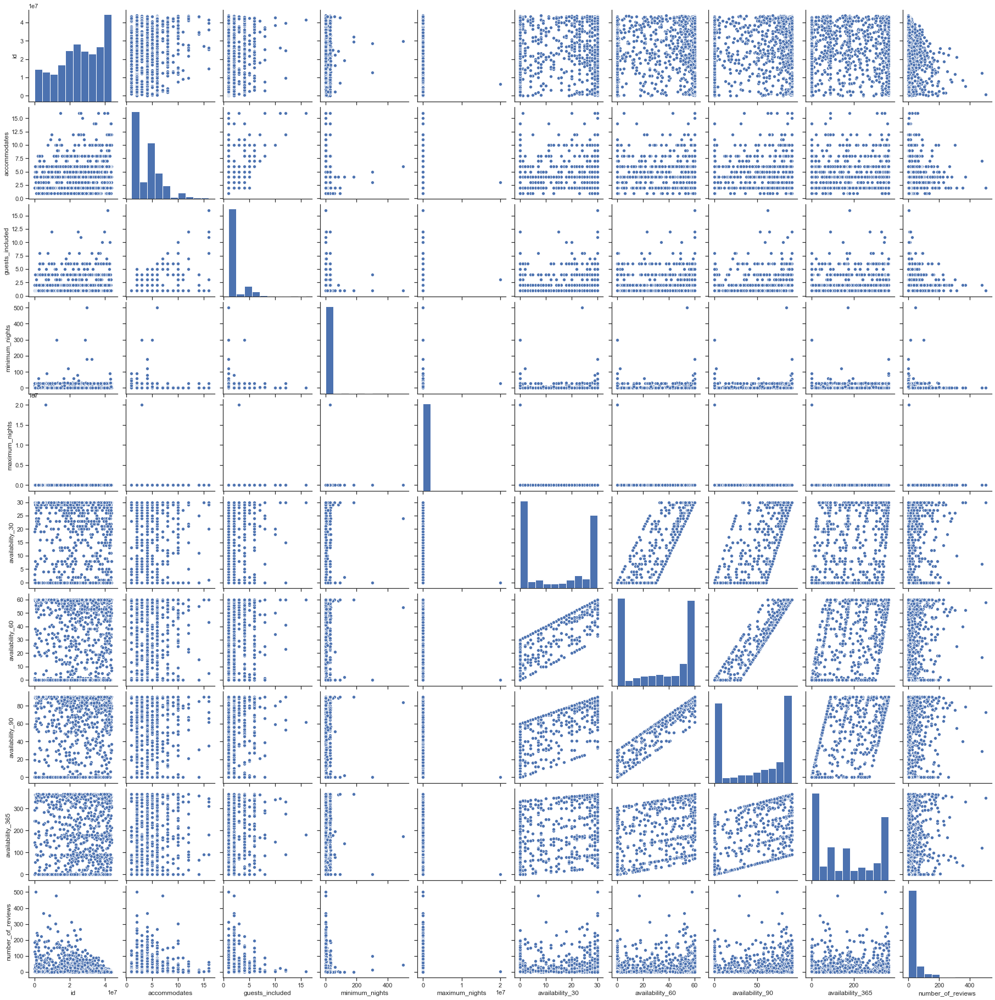

In [9]:
sns.set(style="ticks", color_codes = True)
g = sns.pairplot(df_temp)
path = 'output/'
g.savefig(os.path.join(path,"pairplot_1.png"))

In [15]:
df_temp = df.sample(1000)[numeric_columns[13:23]]


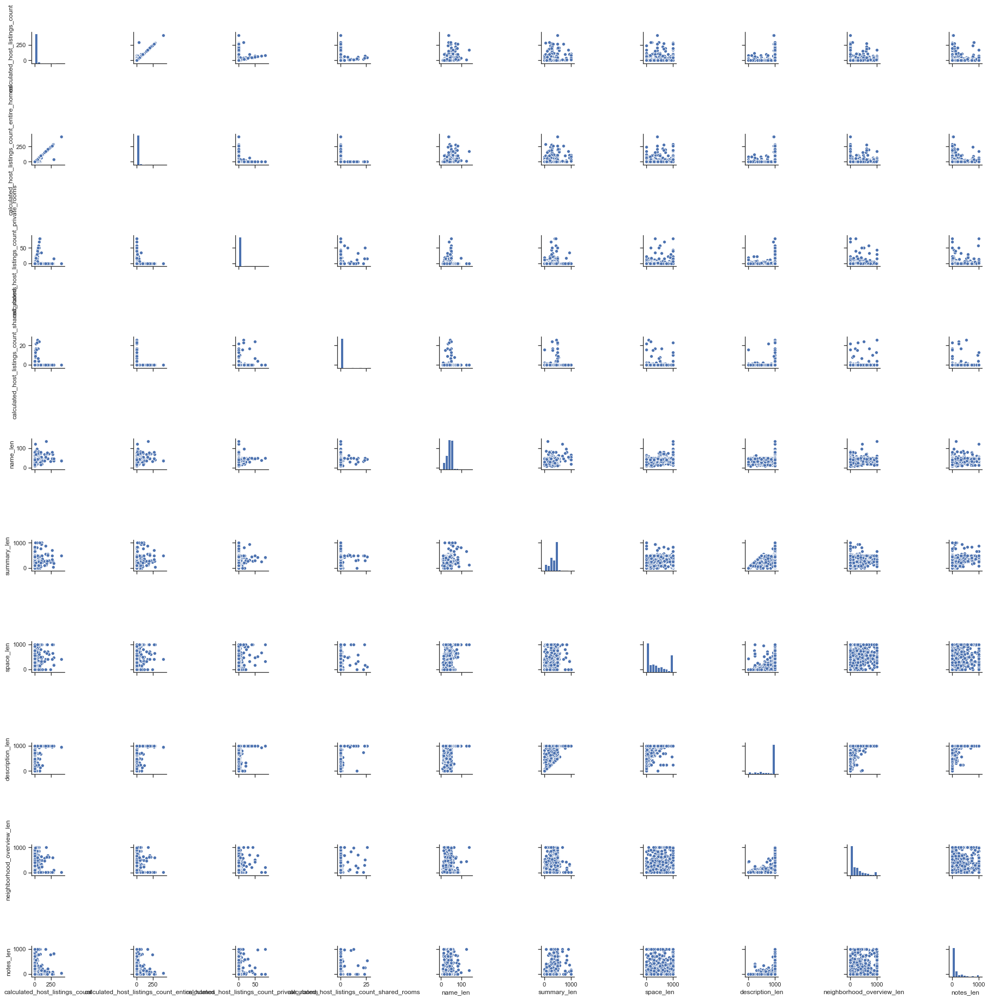

In [16]:
sns.set(style="ticks", color_codes = True)
g = sns.pairplot(df_temp)
g.savefig("pairplot_2.png")

Time out!! This approach is taking way too long!!!

Lesson learned: even pair-plotting exhaustively columns, then eye-balling correlations approach takes 1-2 hours for me. I'll probably visit then when refining my model.

In the spirit of "ship-it" I am pausing here.